## Animate transition from 3D neuron into 2D dendrograms

In [144]:
import time

import pymaid

import networkx as nx
import numpy as np

import matplotlib as mpl
# Increase size limit for animations
mpl.rcParams['animation.embed_limit'] = 100

import matplotlib.pyplot as plt
from matplotlib import animation, rc
from matplotlib.collections import LineCollection
from IPython.display import HTML

import connect_catmaid
rm = connect_catmaid.connect_adult_em()

INFO  : Global CATMAID instance set. Caching is ON. (pymaid)


In [2]:
def tree_layout(x, prog='dot'):
    """ Repositions nodes to represent hierarchical tree layout.
    
    Parameters
    ----------
    x :     CatmaidNeuron
            Neuron to plot. Strongly recommend to downsample the neuron!
    prog :  {'dot','neato','fdp'}
            Graphviz layout to use. Be aware that neato and fdp are 
            extremely slow!
            
    Returns
    -------
    positions :  dict
                 {nodeA: (x1, y1), nodeB: (x2, y2), ...}
    
    """

    if not isinstance(x, (pymaid.CatmaidNeuron, pymaid.CatmaidNeuronList)):
        raise ValueError('Need to pass a CatmaidNeuron')
    elif isinstance(x, pymaid.CatmaidNeuronList):
        if len(x) > 1:
            raise ValueError('Need to pass a SINGLE CatmaidNeuron')
        else:
            x = x[0]

    valid_progs = ['fdp','dot','neato']
    if prog not in valid_progs:
        raise ValueError('Unknown program parameter!')

    # Reroot neuron to soma if necessary
    x.reroot(x.soma)

    # Graphviz expects "len" attribute
    g = x.graph
    nx.set_edge_attributes(g, nx.get_edge_attributes(g, 'weight'), name='len')

    # Calculate layout
    print('Calculating node positions...')
    pos = nx.nx_agraph.graphviz_layout(g, prog=prog)    
    
    return pos

In [7]:
def match_positions(a, b, equal_aspect=True):
    """ Bring coordinates B into the same space as coordinates A.
    
    Parameters
    ----------
    a, b :         array-like | dict
                   Positions to bring into the same space.
                   If dict, must be e.g. {nodeA: (x1, y1), nodeB: (x2, y2), ...}
    equal_aspect : bool, optional
                   If True, will scale both axis by the same value to preserve aspect ratio.
                   
    Returns
    -------
    dict or array
                   Coordinates of B mapped into space of A.
    """
    
    a_values = np.vstack(a.values()) if isinstance(a, dict) else a
    b_values = np.vstack(b.values()) if isinstance(b, dict) else b
    
    # Get min max
    a_min, a_max = np.min(a_values, axis=0), np.max(a_values, axis=0)
    b_min, b_max = np.min(b_values, axis=0), np.max(b_values, axis=0)

    scale = ((a_max-a_min) / (b_max-b_min))
    
    # If we want to keep aspect, scale both axis by the same value
    if equal_aspect:
        scale = max(scale)
    
    if not isinstance(b, dict):
        c = b - b_min
        c *= ((a_max-a_min) / (b_max-b_min))
        c += a_min
    else:
        c = {k: (v-b_min) * ((a_max-a_min) / (b_max-b_min)) + a_min for k,v in b.items()}        
    
    return c    

In [4]:
def morph_scatter(a, b, steps=500):
    """ Animate scatterplot from positions a -> b.
    
    Parameters
    ----------
    a, b :          list | array-like
                    Start and stop positions for scatter plot, respectively. 
                    Shape must be (N, 2).
    steps :         int, optional
                    Number of steps (frames) to divide the animation in.
                    
    Returns
    -------
    matplotlib.animation.FuncAnimation
    """
    
    # Create step-wise vector from a->b
    vecs = (b-a)/steps
    
    # Generate and setup figure
    fig, ax = plt.subplots(figsize=(12, 7))    

    ax.set_aspect('equal')
    ax.set_axis_off()

    pos_min = np.min(a, axis=0)    
    pos_max = np.max(a, axis=0)
    
    ax.set_xlim((pos_min[0], pos_max[0]))
    ax.set_ylim((pos_min[1], pos_max[1]))

    points = ax.scatter([], [], s=.5)

    def init():
        points.set_offsets(a)
        return (points,)

    def animate(i):        
        points.set_offsets(points.get_offsets() + vecs)
        
        pos_min = np.min(points.get_offsets(), axis=0)    
        pos_max = np.max(points.get_offsets(), axis=0)
        
        ax.set_xlim((pos_min[0] - (pos_max[0] - pos_min[0]) * 0.02,
                     pos_max[0] + (pos_max[0] - pos_min[0]) * 0.02,))
        ax.set_ylim((pos_min[1] - (pos_max[1] - pos_min[1]) * 0.02,
                     pos_max[1] + (pos_max[1] - pos_min[1]) * 0.02,))
        
        return (points,)

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=steps, interval=20,
                                   repeat=True,
                                   blit=True)
    
    return anim  

In [143]:
def morph_line(start, stop, steps=500):
    """ Animate LineCollection from positions start to stop.
    
    Parameters
    ----------
    start, stop :   list | array-like
                    Start and stop positions for LineCollection, respectively. 
                    Format must follow [ line_1, line_2, ...] with line_n [(x1, y1), (x2, y2), ... ]
    steps :         int, optional
                    Number of steps (frames) to divide the animation in.
                    
    Returns
    -------
    matplotlib.animation.FuncAnimation
    """
    
    # Calculate step-wise vectors for each line 
    vecs = [(b-a)/steps for a, b in zip(start, stop)]
    
    # Generate and set up figure
    fig, ax = plt.subplots(figsize=(12, 7))
    
    ax.set_aspect('equal')
    ax.set_axis_off()
    
    pos_min = np.min([np.min(s, axis=0) for s in a_segs], axis=0)
    pos_max = np.max([np.max(s, axis=0) for s in a_segs], axis=0)
    
    ax.set_xlim((pos_min[0], pos_max[0]))
    ax.set_ylim((pos_min[1], pos_max[1]))

    # Generate empty LineCollection and add to figure
    lc = LineCollection([])
    ax.add_collection(lc)  

    def init():
        # Set start positions
        lc.set_paths(start)
        return (lc,)

    def animate(i):
        # Change vertices of each line
        for p, v in zip(lc.get_paths(), vecs):
            p.vertices += v
        
        # Make sure the figure shows the entire plot
        pos_min = np.min([np.min(p.vertices, axis=0) for p in lc.get_paths()], axis=0)
        pos_max = np.max([np.max(p.vertices, axis=0) for p in lc.get_paths()], axis=0)
        
        ax.set_xlim((pos_min[0] - (pos_max[0] - pos_min[0]) * 0.02,
                     pos_max[0] + (pos_max[0] - pos_min[0]) * 0.02,))
        ax.set_ylim((pos_min[1] - (pos_max[1] - pos_min[1]) * 0.02,
                     pos_max[1] + (pos_max[1] - pos_min[1]) * 0.02,))
        
        return (lc,)

    # Create animation
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=steps, interval=20,
                                   repeat=True,
                                   blit=True)
    
    return anim  

First, get a neuron and downsample a bit to speed up processing

In [23]:
n = pymaid.get_neuron(16)
n.downsample(2, inplace=True)
n

INFO  : Cached data used. Use `pymaid.clear_cache()` to clear. (pymaid)
INFO  : Cached data used. Use `pymaid.clear_cache()` to clear. (pymaid)


,
type,<class 'pymaid.core.CatmaidNeuron'>
neuron_name,PN glomerulus VA6 017 DB
skeleton_id,16
n_nodes,5587
n_connectors,2108
n_branch_nodes,774
n_end_nodes,823
n_open_ends,280
cable_length,2609.65
review_status,NA


Now get node positions in desired layout

In [6]:
pos = tree_layout(n, prog='neato')

Calculating node positions...


Here we generate the lines for the `LineCollection`.

In [ ]:
# Get nodes x/y coordinates (for frontal view)
a = n.nodes.set_index('treenode_id')[['x','y']].copy()

# Invert y axis (remember that the origin in CATMAID is in the top left corner)
a *= [1, -1]

# Offset so that the bounding box starts at (0, 0)
a -= np.min(a.values, axis=0)

# Combine x and y coordinate into a single tuple
a['pos'] = list(zip(a.x, a.y))

# Generate a dictionary mapping treenode ID -> (x, y)
a_pos = a.pos.to_dict()

# Bring dendrogram positions into the same bounding box
b_pos = match_positions(a_pos, pos)

# Create the actual lines for LineCollection 
a_segs = [np.array([(a_pos[tn]) for tn in s]) for s in n.segments]
b_segs = [np.array([list(b_pos[tn]) for tn in s]) for s in n.segments]

We have the start and stop positions for all lines - let's plot!

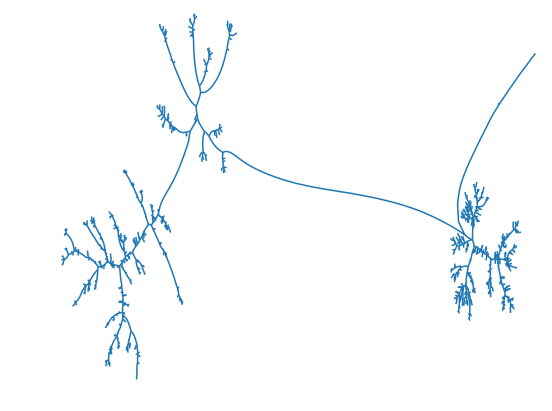

In [152]:
# Generate animation
anim = morph_line(a_segs, b_segs)

# Show interactive animation
HTML(anim.to_jshtml())

We can also save the frames individually. For that you need to have `imagemagick` installed. On MacOs you can use homebrew to do that. In terminal run:
```
brew install imagemagick
```
Please note that you will need to restart the Python Kernel of this notebook after installing `imagemagick`.

In [153]:
anim.save('frames/frame.png', writer='imagemagick')

Use Fiji to import animation as image sequence and save as e.g. AVI or GIF.

You can also directly save to a GIF but this will give you less control over framerate, looping etc.

In [120]:
anim.save('neuron2dendrogram.gif', dpi=200, writer='pillow')